In [60]:
import geopandas as gpd
import pandas as pd
import folium
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.colors as mcolors

## Do Areas with higher deprivation have lower EPC certificate ratings?

### Data Sources

#### EPC Certificates
EPC Certificates, Ministry of Housing, Communities & Local Government. (n.d.). Energy Performance Certificates [online]. Available at: https://epc.opendatacommunities.org/ [Accessed 01 May 2024].

#### UPRN Location Data
UPRN Location Data, Ordnance Survey. (n.d.). Open UPRN [online]. Available at: https://osdatahub.os.uk/downloads/open/OpenUPRN?_gl=1*1whbqin*_ga*MTQ0OTY4MTE2LjE3MTQ0NzAwNjM.*_ga_59ZBN7DVBG*MTcxNDQ3MDA2Mi4xLjEuMTcxNDQ3MDA2OS41My4wLjA.&_ga=2.194552365.1465662779.1714470063-144968116.1714470063 [Accessed 01 May 2024].

#### Leeds Boundary
Leeds Boundary, UK Data Service. (n.d.). Boundary Data Selector [online]. Available at: https://borders.ukdataservice.ac.uk/bds.html [Accessed 01 May 2024].

#### IMD scores by LSOA
IMD scores by LSOA. (2019). English Indices of Deprivation 2019 [online]. Available at: https://data-communities.opendata.arcgis.com/datasets/4ad3e5a10872455eaa67ce4e663d0d01_0/explore?location=53.792351%2C-1.606264%2C11.12 [Accessed 01 May 2024].

### Data Processing


#### Data Import and Cleaning

In [2]:
# / File path to EPC records
in_file_EPC = "./Data/certificates.csv"

# / File path to IMD shapefile
in_file_IMD = "./Data/Indices_of_Multiple_Deprivation_IMD_2019_Leeds_Area/Indices_of_Multiple_Deprivation_(IMD)_2019.shp"

# / File path to Leeds amdministative boundaries
in_file_Leeds_Ad_Boundary = "Data/BoundaryData_Leeds/england_ltla_2022.shp"

# / File path to UPRN lookup
in_file_UPRN = "Data/osopenuprn_202404.gpkg"


In [89]:
# define a funciton to use when exploring these datasets
def describe_df(df):
    print('Length of Df:')
    print(len(df))

    print('Df Head:')
    print(df.head())

    print('Df Columns:')
    print(list(df.columns))

    print('Describe Df:')
    print(df.describe())

    print('----------- Describe df End ------------')

In [90]:
# read in EPC (All of Leeds)
epc_gdf = pd.read_csv(in_file_EPC)

# read in IMD (UK Wide) and convert to appropriate crs
imd_gdf = gpd.read_file(in_file_IMD)
imd_gdf = imd_gdf.to_crs(27700)

# read in Leeds Study area boundary and get the bounding box as a tuple
Leeds_Boundary_gdf = gpd.read_file(in_file_Leeds_Ad_Boundary)
bbox = Leeds_Boundary_gdf.bounds

describe_df(epc_gdf)
describe_df(imd_gdf)
describe_df(Leeds_Boundary_gdf)


/var/folders/sz/n80kgmcs43b6swmgv_64_48c0000gn/T/ipykernel_58440/3737078757.py:2: DtypeWarning: Columns (15,37) have mixed types. Specify dtype option on import or set low_memory=False.
  epc_gdf = pd.read_csv(in_file_EPC)


Length of Df:
356708
Df Head:
                                             LMK_KEY              ADDRESS1  \
0  001dca82162cbdf798f746f53027c0cc82afda971d5e84...                Flat 2   
1  18a413eb393a87aaccdcbbc35d75c519a13bf9713e5d8d...    8 Sackville Street   
2  18ad988b1d1a739e5adfd04531c27c63e7ea810f40c31d...  20 Highfield Gardens   
3  18bd4432597b334e2d8031b1ded0e4d713f2133e939b89...  17 Chestnut Gardens    
4                  275687798052018050310193492080467   9, Foxwood Farm Way   

          ADDRESS2 ADDRESS3  POSTCODE  BUILDING_REFERENCE_NUMBER  \
0  35a Town Street  Farsley  LS28 5HX                10003805692   
1              NaN      NaN   LS7 2AS                10003489215   
2              NaN      NaN  LS12 4DU                10003423919   
3              NaN      NaN  LS12 4LP                10002989904   
4              NaN      NaN   LS8 3EE                 4759821668   

  CURRENT_ENERGY_RATING POTENTIAL_ENERGY_RATING  CURRENT_ENERGY_EFFICIENCY  \
0             

After exploing the data a little it is clear there is no location data on the EPC certificates. However, we can link these to a UPRN lookup to get point locations for each.


In [91]:
# read in the UPRN file, as this dataset is very large only read features within the bounds of the study area to improve code performance
# calculate total bounds & construct tuple to use when reading in a subset of a file in geopandas
min_x = bbox['minx'].min()
min_y = bbox['miny'].min()
max_x = bbox['maxx'].max()
max_y = bbox['maxy'].max()
bbox_tuple = (min_x, min_y, max_x, max_y)

UPRN_Leeds_bbox_gdf = gpd.read_file(in_file_UPRN, bbox=bbox_tuple)
# describe_df(UPRN_Leeds_bbox_gdf)

# link UPRN to EPCs & convert back to GeoDataFrame - geometry is lost in pandas merge
joined_EPC_df = pd.merge(epc_gdf, UPRN_Leeds_bbox_gdf, on='UPRN', how='inner', validate="many_to_many")
joined_EPC_gdf = gpd.GeoDataFrame(joined_EPC_df, geometry='geometry')

# spatial join to filter features futher to only wthin the boundary selected
intersecting_epc_features = gpd.sjoin(joined_EPC_gdf, Leeds_Boundary_gdf, how="inner", op='intersects')

# spatial join to filter features from the imd layer in leeds
intersecting_imd_features = gpd.sjoin(imd_gdf, Leeds_Boundary_gdf, how="inner", op='intersects')

# attatch to each EPC feature the IMD columns using an sjoin, drop index_right to prevent error when joining
intersecting_epc_features.drop(columns=['index_right'], inplace=True)
intersecting_imd_features.drop(columns=['index_right'], inplace=True)
intersecting_epc_features_imd_attatched = gpd.sjoin(intersecting_epc_features, intersecting_imd_features, how="inner", op='intersects')

# Then, drop the columns we are not using for the visualisations, resultng in a smaller df and faster code.

# Drop all columns except the IMD decile and the geometry (for visualisation)
keep_cols_imd = ['IMD_Decile', 'geometry']
cols_to_drop = set(intersecting_imd_features.columns) - set(keep_cols_imd)
intersecting_imd_features.drop(columns=cols_to_drop, inplace=True)

# Drop all columns except the Current, Potential Energy Efficiency and the geometry (for map visualisation)
keep_cols_epc = ['CURRENT_ENERGY_RATING', 'POTENTIAL_ENERGY_RATING', 'geometry']
cols_to_drop = set(intersecting_epc_features.columns) - set(keep_cols_epc)
intersecting_epc_features.drop(columns=cols_to_drop, inplace=True)

# Drop all columns except the Current, Potential Energy Efficiency, and IMD Decile geometry (for chart visualisation)
keep_cols_epc = ['CURRENT_ENERGY_RATING', 'POTENTIAL_ENERGY_RATING', 'IMD_Decile', 'geometry']
cols_to_drop = set(intersecting_epc_features_imd_attatched.columns) - set(keep_cols_epc)
intersecting_epc_features_imd_attatched.drop(columns=cols_to_drop, inplace=True)

/Users/alexandertrout/opt/anaconda3/envs/mac_conda_py3_10/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3490: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
/Users/alexandertrout/opt/anaconda3/envs/mac_conda_py3_10/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3490: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
/Users/alexandertrout/opt/anaconda3/envs/mac_conda_py3_10/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3490: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


### Data Visualisation

#### Charting

In [92]:
def count_df_multiple_groups(df, group_cols):
    # Group by IMD_Decile and CURRENT_ENERGY_RATING, then count the occurrences
    count_df = df.groupby(group_cols).size().unstack(fill_value=0)
    count_df = count_df.reset_index()

    return count_df

def add_total_epc_count_column(count_df_epc):
    count_df_epc['Total'] = count_df_epc['A'] + count_df_epc['B'] + count_df_epc['C'] + count_df_epc['D'] + count_df_epc['E'] + count_df_epc['F'] + count_df_epc['G'] 
    return count_df_epc

def create_percentage_of_total_per_epc(count_df_epc):
    # Create a new DataFrame to store percentages
    percentage_df = count_df_epc.copy()

    # Calculate percentages for each EPC rating
    epc_columns = ['A', 'B', 'C', 'D', 'E', 'F', 'G']
    for epc in epc_columns:
        percentage_df[epc] = (percentage_df[epc] / percentage_df['Total'] * 100).round(2)

    percentage_df.drop(columns=['Total'], inplace=True)
    return percentage_df

In [93]:
# group the epc_features by counting how many lie within each imd decile
group_cols = ['IMD_Decile', 'CURRENT_ENERGY_RATING']
count_epc_df = add_total_epc_count_column(count_df_multiple_groups(intersecting_epc_features_imd_attatched, group_cols))

# add a count of 
percent_df_epc =  create_percentage_of_total_per_epc(count_epc_df)

# melt the dfs to long format (so they can be plotted)
count_df_melted = count_epc_df.melt(id_vars='IMD_Decile', var_name='CURRENT_ENERGY_RATING', value_name='Count')
percent_df_melted = percent_df_epc.melt(id_vars='IMD_Decile', var_name='CURRENT_ENERGY_RATING', value_name='Count')

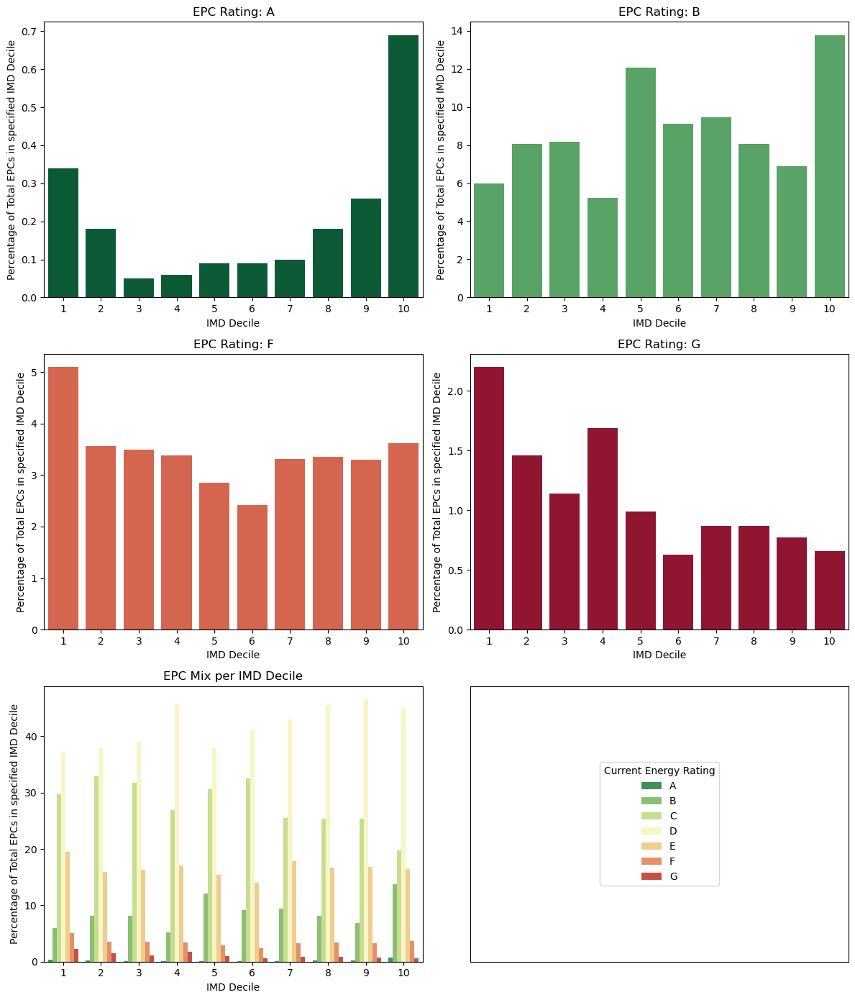

In [94]:
# generate a colormap so the visualisation matches the map visualisation for consistency
cmap = plt.get_cmap("RdYlGn_r")
colors = [cmap(i / (len(['A', 'B', 'C', 'D', 'E', 'F', 'G']) - 1)) for i in range(len(['A', 'B', 'C', 'D', 'E', 'F', 'G']))]

# define the columns to include in the subplots (charting only the extremes)
columns_to_include = ['A', 'B', 'F', 'G']
indices = [['A', 'B', 'C', 'D', 'E', 'F', 'G'].index(c) for c in columns_to_include]
subset_colors = [colors[i] for i in indices]

# create subplots
fig, axes = plt.subplots(3, 2, figsize=(12, 14))

# plot each EPCs percentage column as a subplot
axes = axes.flatten()
for idx, col in enumerate(columns_to_include):
    sns.barplot(ax=axes[idx], data=percent_df_epc, 
                x='IMD_Decile', y=col, color=subset_colors[idx])
    axes[idx].set_title(f'EPC Rating: {col}')
    axes[idx].set_xlabel('IMD Decile')
    axes[idx].set_ylabel('Percentage of Total EPCs in specified IMD Decile')

# add a chart showing all epcs percentages per IMD Decile for context. Adjust titles, labels.
sns.barplot(data=percent_df_melted, x='IMD_Decile', y='Count', hue='CURRENT_ENERGY_RATING', palette='RdYlGn_r', ax=axes[4])
axes[4].set_title('EPC Mix per IMD Decile')
axes[4].set_xlabel('IMD Decile')
axes[4].set_ylabel('Percentage of Total EPCs in specified IMD Decile')

# give the legend from the previous plot to the subplot in axes location 5
legend = axes[4].legend(title='Current Energy Rating')
handles, labels = axes[4].get_legend_handles_labels()
axes[5].legend(handles, labels, title='Current Energy Rating', loc='center', bbox_to_anchor=(0.5, 0.5))
axes[5].set_title('')
axes[5].set_xlabel('')
axes[5].set_ylabel('')
axes[5].set_xticks([])
axes[5].set_yticks([])

# don't show the legend on the subplot in axes location 4, so axes 5 acts as a legend for all charts
axes[4].legend().set_visible(False)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()


#### Mapping

In [87]:
#  filter down to only most interesting EPC ratings, focus on areas with good / pooe EPC ratings
filtered_gdf_a_b_f_g = intersecting_epc_features[intersecting_epc_features['CURRENT_ENERGY_RATING'].isin(['A','B', 'F', 'G'])]

# Add Layers to visualisaiton
m = intersecting_imd_features.explore("IMD_Decile", cmap="Blues", name="Polygons")
m = filtered_gdf_a_b_f_g.explore("CURRENT_ENERGY_RATING",  categorical=True, cmap="RdYlGn_r", name="Points", m=m)

# Add layer control to the map
folium.LayerControl().add_to(m)

# Show Map
m